In [1]:
import pandas as pd
import numpy as np
# data viz
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.simplefilter(action = 'ignore',category = FutureWarning)

In [3]:
df = pd.read_csv('DailySales_sorted.csv')

In [4]:
df.shape

(74824, 189)

In [5]:
fresh_foods = df[df['dept_name'].str.find('FRESH') != -1]

In [6]:
fresh_foods.head()

,item_desc,dept,dept_name,class,class_name,subclass,sub_name,Item,2020-01-01,2020-01-02,...,2020-06-20,2020-06-21,2020-06-22,2020-06-23,2020-06-24,2020-06-25,2020-06-26,2020-06-27,2020-06-28,2020-06-29
66123,#SIAKAP - KG (9065),266,FRESH SEAFOOD,1,FRESH FISH,1,BASS,1495569,28795.0,23569.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66124,GERUT (KG) (9011),266,FRESH SEAFOOD,1,FRESH FISH,2,BREAM/SNAPPER(JENAHAK),1770527,0.0,13.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66125,CLEANED KELI FISH (KG) (9009),266,FRESH SEAFOOD,1,FRESH FISH,3,CAT FISH,7765,1872.0,1339.0,...,2600.0,2775.0,3098.0,2002.0,2028.0,2171.0,2600.0,3198.0,2759.0,2416.0
66126,IKAN SEBELAH - KG (8623),266,FRESH SEAFOOD,1,FRESH FISH,5,FLAT FISH/SHARK,73230944,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66127,IKAN SEBELAH - KG (8624),266,FRESH SEAFOOD,1,FRESH FISH,5,FLAT FISH/SHARK,73231150,65.0,78.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


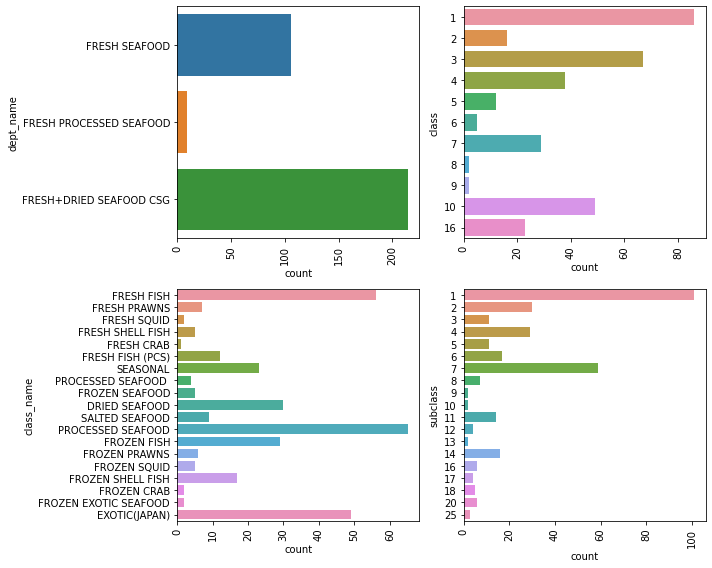

In [7]:
plt.figure(figsize = (10,8))
cat_cols = ['dept_name','class','class_name','subclass']
i = 1
for col in cat_cols:
    plt.subplot(2,2,i)
    sns.countplot(y = fresh_foods[col])
    plt.xticks(rotation = 90)
    plt.tick_params(labelbottom = True)
    i += 1
plt.tight_layout()

In [8]:
fresh_foods = fresh_foods.drop(['dept','dept_name','class','class_name','subclass','sub_name','Item'],axis = 1)

In [9]:
fresh_foods

,item_desc,2020-01-01,2020-01-02,2020-01-03,2020-01-04,2020-01-05,2020-01-06,2020-01-07,2020-01-08,2020-01-09,...,2020-06-20,2020-06-21,2020-06-22,2020-06-23,2020-06-24,2020-06-25,2020-06-26,2020-06-27,2020-06-28,2020-06-29
66123,#SIAKAP - KG (9065),28795.0,23569.0,29380.0,41158.0,37949.0,29135.0,24440.0,23036.0,17446.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66124,GERUT (KG) (9011),0.0,13.0,0.0,13.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66125,CLEANED KELI FISH (KG) (9009),1872.0,1339.0,1989.0,1690.0,1773.0,1838.0,1404.0,1378.0,1586.0,...,2600.0,2775.0,3098.0,2002.0,2028.0,2171.0,2600.0,3198.0,2759.0,2416.0
66126,IKAN SEBELAH - KG (8623),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66127,IKAN SEBELAH - KG (8624),65.0,78.0,91.0,91.0,13.0,48.0,91.0,26.0,26.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66447,SEA WHITE PRAWN-KG (8178),39.0,26.0,91.0,195.0,169.0,128.0,39.0,39.0,26.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66448,WHOLE SHELL MUSSEL 400GM (9439),156.0,91.0,52.0,78.0,143.0,16.0,26.0,39.0,39.0,...,247.0,169.0,128.0,91.0,104.0,91.0,169.0,182.0,208.0,160.0
66449,FRZ MIXED SEAFOOD 200MG,13.0,13.0,39.0,13.0,0.0,16.0,13.0,13.0,26.0,...,52.0,52.0,0.0,52.0,52.0,26.0,26.0,52.0,104.0,48.0
66450,PROMOTIONS RM5/PACK (8525),13.0,13.0,13.0,26.0,52.0,48.0,52.0,143.0,65.0,...,260.0,247.0,240.0,78.0,182.0,91.0,117.0,377.0,260.0,368.0


In [10]:
# to do: pivot the results from wide to long
fresh_foods = pd.pivot_table(fresh_foods,columns = ['item_desc'])
fresh_foods.index = pd.to_datetime(fresh_foods.index)

In [11]:
food_remove = []
for food in fresh_foods.columns:
    zero_days = len(fresh_foods[fresh_foods[food] == 0])
    all_days = len(fresh_foods)
    if zero_days >= all_days * 1/4:
        food_remove.append(food)

In [12]:
food_remove

['#SIAKAP - KG (9065)',
 'AAA BEBOLA IKAN GORENG BESAR 160G',
 'AAA BEBOLA IKAN GORENG KECIL 160G',
 'AAA BEBOLA IKAN SAYUR 160G',
 'AAA Bebola Ikan Putih Kecil 135g',
 'AAA KUIH IKAN 220G',
 'ABALONE - PCS (8399)',
 'ANGRY BIRD 6 PCS/PACK',
 'ASSORTED STEAMBOAT BALL CRAB 4 IN 1',
 'ASSORTED STEAMBOAT BALL FANCY 3 IN 1',
 'ASSORTED STEAMBOAT BALL FLAVOR 5 IN 1',
 'ASSORTED STEAMBOAT BALL IMITATE 3 IN 1',
 'ASSORTED STEAMBOAT BALL TOFU 2 IN 1',
 'ATLANTIC COD FISH BLOCK ( 8605)',
 'ATLANTIC COD FISH BLOCK (KG) (8819)',
 'AUS BANANA PRAWN 21/30 - KG',
 'AUS TIGER PRAWN 31/40 - KG',
 'BARRAMUNDI FILLET',
 'BARRAMUNDI FILLET (PACK)',
 'BAWAL TAMBAK PCS (400 - 500 gm)',
 'BAWAL TAMBAK PCS (500 - 700 gm)',
 'BBQC UNAGI 200MG',
 'BEBOLA IKAN GORENG KECIL 170G/PKT????',
 'BEBOLA KETAM MAS 8PCS/ PKT???',
 'CB SMOKE SLICE ABALONE 300G',
 'CENCARU (FZN) (KG) (8141)',
 'CHILI SAUCE 100ML',
 'CILI BEBOLA IKAN PUTIH KECIL 160G/PKT',
 'COD STEAK PER KG',
 'CRAB CLAW 5 PCS/PACK',
 'CRAB DUMPLING 10PCS

In [13]:
fresh_foods = fresh_foods.drop(food_remove,axis = 1)
fresh_foods.head(3)

item_desc,#CENCARU (KG) (9007),#SOTONG PUTIH (KG) (9067),#UDANG SEDERHANA (KG)(9085),333 GOLD LONG FISH CAKE 200G/PACK,333 GOLD SMALL WHITE FISH BALL 135G/PACK,BALITONG (KG) (9001),BAWAL EMAS PCS (8148),BAWAL HITAM (KG) (9003),BEBOLA IKAN PUTEH KECIL 170G/PKT?????,BEBOLA IKAN PUTEH KECIL 450G/PKT,...,UDANG GERAGAU?100G,UDANG HARIMAU L (KG) (9081),UDANG KERING JUMBO (8379),UDANG KERING MERAH 150G,UDANG KERING MERAH 75G,UG STEAMBOAT BALLS ASSORTED KG,UG YONG TOFU ASSORTED PCS,US SCALLOP MEAT(20/30) 200G,WHOLE SHELL MUSSEL 400GM (9439),WHOLE SOTONG RENDAM PCS (8738)
2020-01-01,12623.0,9646.0,113048.0,2353.0,2015.0,65.0,51441.0,2951.0,364.0,1963.0,...,598.0,78.0,1248.0,182.0,767.0,195.0,182.0,403.0,156.0,6890.0
2020-01-02,7423.0,7930.0,87230.0,1651.0,1313.0,39.0,41951.0,2275.0,442.0,1157.0,...,481.0,117.0,845.0,39.0,455.0,169.0,130.0,156.0,91.0,5421.0
2020-01-03,8138.0,7579.0,91910.0,2431.0,1989.0,715.0,65910.0,2847.0,546.0,1352.0,...,585.0,130.0,858.0,91.0,585.0,52.0,208.0,403.0,52.0,6903.0


<AxesSubplot:title={'center':'Series before normalization'}>

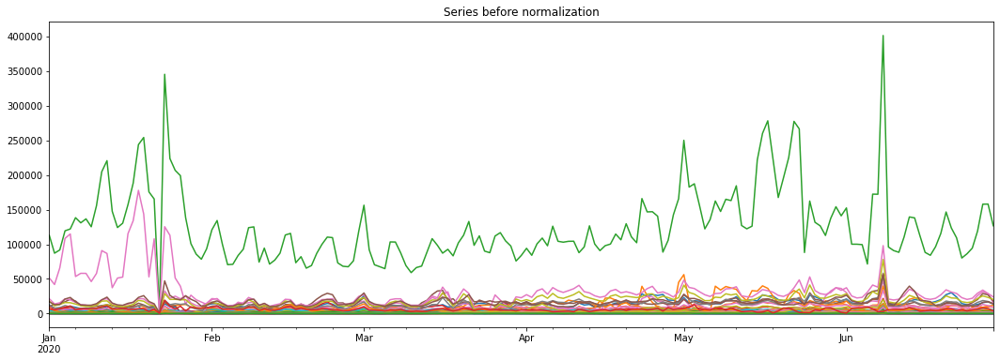

In [14]:
fresh_foods.plot(figsize = (18,6),legend = None,title = 'Series before normalization')

# Normalization

In [15]:
df_normalized = pd.DataFrame()
for food in fresh_foods.columns:
    df_normalized[food] = (fresh_foods[food] - fresh_foods[food].mean()) / fresh_foods[food].std()

df_normalized.index = fresh_foods.index

C:\Users\Jiarui\AppData\Local\Temp/ipykernel_27928/4231545414.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df_normalized[food] = (fresh_foods[food] - fresh_foods[food].mean()) / fresh_foods[food].std()


In [16]:
df_normalized.head(3)

,#CENCARU (KG) (9007),#SOTONG PUTIH (KG) (9067),#UDANG SEDERHANA (KG)(9085),333 GOLD LONG FISH CAKE 200G/PACK,333 GOLD SMALL WHITE FISH BALL 135G/PACK,BALITONG (KG) (9001),BAWAL EMAS PCS (8148),BAWAL HITAM (KG) (9003),BEBOLA IKAN PUTEH KECIL 170G/PKT?????,BEBOLA IKAN PUTEH KECIL 450G/PKT,...,UDANG GERAGAU?100G,UDANG HARIMAU L (KG) (9081),UDANG KERING JUMBO (8379),UDANG KERING MERAH 150G,UDANG KERING MERAH 75G,UG STEAMBOAT BALLS ASSORTED KG,UG YONG TOFU ASSORTED PCS,US SCALLOP MEAT(20/30) 200G,WHOLE SHELL MUSSEL 400GM (9439),WHOLE SOTONG RENDAM PCS (8738)
2020-01-01,-0.190104,-0.305509,-0.231444,-0.373845,-0.367739,-0.833571,1.032002,-0.154964,-0.526875,0.124556,...,-0.354937,-0.627778,-0.603627,-0.322157,-0.619507,-0.495805,0.004179,0.756845,-0.026226,0.406293
2020-01-02,-0.960382,-0.484401,-0.711748,-0.799714,-0.864746,-0.857403,0.701858,-0.665843,-0.268588,-0.823233,...,-0.695035,-0.393457,-0.909376,-0.926431,-0.918525,-0.572135,-0.190545,-0.315008,-0.675805,-0.198609
2020-01-03,-0.854469,-0.520992,-0.624684,-0.326526,-0.386146,-0.237762,1.535359,-0.233561,0.075796,-0.593929,...,-0.392726,-0.315349,-0.899513,-0.706695,-0.793934,-0.915621,0.101541,0.756845,-1.065553,0.411647


<AxesSubplot:title={'center':'series after normalization'}>

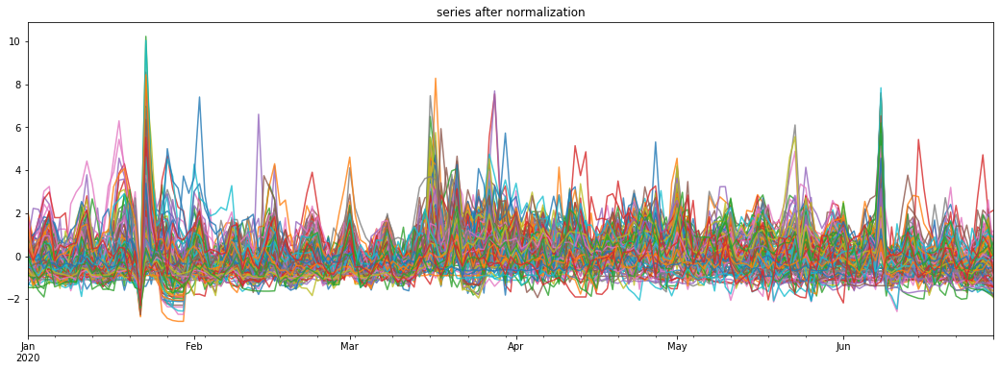

In [17]:
df_normalized.plot(figsize = (18,6),legend = None, alpha = 0.8,title = 'series after normalization')

In [18]:
# to do: calculate mse and mae
from sklearn.metrics import mean_squared_error, mean_absolute_error
food_A = []
food_B = []
mse_AB = []
mae_AB = []
 
for food_a in df_normalized.columns:
    for food_b in df_normalized.columns:
        mse_ab = mean_squared_error(df_normalized[food_a],df_normalized[food_b])
        mae_ab = mean_absolute_error(df_normalized[food_a],df_normalized[food_b])
        food_A.append(food_a)
        food_B.append(food_b)
        mse_AB.append(mse_ab)
        mae_AB.append(mae_ab)

In [19]:
result = pd.DataFrame({'food_A':food_A,'food_B':food_B,'MSE_AB':mse_AB,'MAE_AB':mae_AB})
result = result[result.food_A != result.food_B]

In [20]:
# to do: find minimum mse for every pair of items
a = pd.DataFrame(result.groupby(['food_A'])['MSE_AB'].min())
b = pd.merge(a,result,on = ['MSE_AB','food_A'],how = 'left')
#b = b.groupby(['food_A'])['food_B','MSE_AB'].min()
b.head(10)

,MSE_AB,food_A,food_B,MAE_AB
0,0.266227,#CENCARU (KG) (9007),MABONG (KG) (8647),0.372953
1,0.364116,#SOTONG PUTIH (KG) (9067),IKAN TERUBOK - PCSS(8346),0.457100
2,0.741276,#UDANG SEDERHANA (KG)(9085),PATIN HITAM (KG) (9055),0.619701
3,0.102914,333 GOLD LONG FISH CAKE 200G/PACK,333 GOLD SMALL WHITE FISH BALL 135G/PACK,0.208779
4,0.102914,333 GOLD SMALL WHITE FISH BALL 135G/PACK,333 GOLD LONG FISH CAKE 200G/PACK,0.208779
5,0.733605,BALITONG (KG) (9001),KERAPU BLOCK (KG) (8698),0.622243
6,0.170950,BAWAL EMAS PCS (8148),FRZ SEA CUCUMBER 500G,0.267442
7,0.585882,BAWAL HITAM (KG) (9003),MUSHROOM SMALL FRIED FISHBALL 160G/PKT,0.572537
8,0.332903,BEBOLA IKAN PUTEH KECIL 170G/PKT?????,KEK IKAN PANJANG 450G/PKT,0.405603
9,0.189465,BEBOLA IKAN PUTEH KECIL 450G/PKT,KEK IKAN PANJANG 450G/PKT,0.322415


In [21]:
b.index = b.food_A

In [22]:
b.drop(columns = ['MAE_AB'],inplace = True)

In [23]:
b.head()

,MSE_AB,food_A,food_B
food_A,,,
#CENCARU (KG) (9007),0.266227,#CENCARU (KG) (9007),MABONG (KG) (8647)
#SOTONG PUTIH (KG) (9067),0.364116,#SOTONG PUTIH (KG) (9067),IKAN TERUBOK - PCSS(8346)
#UDANG SEDERHANA (KG)(9085),0.741276,#UDANG SEDERHANA (KG)(9085),PATIN HITAM (KG) (9055)
333 GOLD LONG FISH CAKE 200G/PACK,0.102914,333 GOLD LONG FISH CAKE 200G/PACK,333 GOLD SMALL WHITE FISH BALL 135G/PACK
333 GOLD SMALL WHITE FISH BALL 135G/PACK,0.102914,333 GOLD SMALL WHITE FISH BALL 135G/PACK,333 GOLD LONG FISH CAKE 200G/PACK


In [25]:
df_normalized.iloc[0,:]['MABONG (KG) (8647)']

-0.6491923295784544

In [26]:
b.loc['MABONG (KG) (8647)']['food_B']

'CLEANED KELI FISH (KG) (9009)'

In [27]:
df_normalized[['MABONG (KG) (8647)','CLEANED KELI FISH (KG) (9009)']]

,MABONG (KG) (8647),CLEANED KELI FISH (KG) (9009)
2020-01-01,-0.649192,-0.486525
2020-01-02,-0.652847,-1.024055
2020-01-03,-1.138932,-0.368531
2020-01-04,-0.663811,-0.670072
2020-01-05,-0.507781,-0.586367
...,...,...
2020-06-25,-0.422596,-0.184984
2020-06-26,0.271811,0.247662
2020-06-27,1.309767,0.850744
2020-06-28,0.833522,0.408013


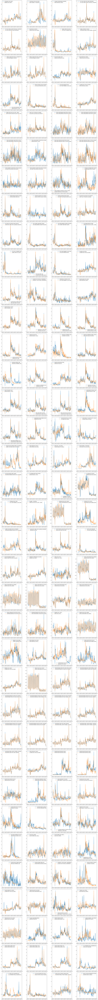

In [28]:
plt.figure(figsize = (20,200))
i  = 1
for food_A in b.index:
    plt.subplot(36,4,i)
    food_B = b.loc[food_A]['food_B']
    df_viz = df_normalized[[food_A,food_B]]
    sns.lineplot(data = df_viz)
    i += 1
plt.tight_layout()

# Test if it is spurious regression

The reason why we want to conduct cointegration analysis is due to the fact that spurious regression <br>
1. ice cream sales number and childern who drawn <br>
2. household consumption and number of Cormorants <br>

The reason that lead to spurious regression is two reason:
1. confounding factor <br> there exists another factor like hot weather in first case.
2. local stochastic trend <br>

spurious regression happened a lot when we regress two series that is not stationary

from our data, we can clear see that sales data is not stationary

In [29]:
df_normalized.iloc[:,1]

2020-01-01   -0.305509
2020-01-02   -0.484401
2020-01-03   -0.520992
2020-01-04   -0.423415
2020-01-05   -0.557480
                ...   
2020-06-25   -0.544031
2020-06-26   -0.546742
2020-06-27   -0.390889
2020-06-28   -0.294563
2020-06-29   -0.352004
Name: #SOTONG PUTIH (KG) (9067), Length: 181, dtype: float64

In [35]:
# adf test
from statsmodels.tsa.stattools import adfuller
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm

In [31]:
def adf_test(timeseries):
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    if dfoutput[0] < dfoutput[5]:
        result = 'stationary'
    else:
        result = 'non-stationary'
    return result

In [32]:
def regression_test(y,x):
    x = sm.add_constant(x)
    mod = sm.OLS(y,x)
    fii = mod.fit()
    ols_result = fii.summary2().tables[1]
    beta = ols_result['Coef.'][1]
    p_value = ols_result['P>|t|'][1]
    resid = fii.resid
    adf_result = adf_test(resid)     
    return beta,p_value,adf_result

In [33]:
df_normalized

,#CENCARU (KG) (9007),#SOTONG PUTIH (KG) (9067),#UDANG SEDERHANA (KG)(9085),333 GOLD LONG FISH CAKE 200G/PACK,333 GOLD SMALL WHITE FISH BALL 135G/PACK,BALITONG (KG) (9001),BAWAL EMAS PCS (8148),BAWAL HITAM (KG) (9003),BEBOLA IKAN PUTEH KECIL 170G/PKT?????,BEBOLA IKAN PUTEH KECIL 450G/PKT,...,UDANG GERAGAU?100G,UDANG HARIMAU L (KG) (9081),UDANG KERING JUMBO (8379),UDANG KERING MERAH 150G,UDANG KERING MERAH 75G,UG STEAMBOAT BALLS ASSORTED KG,UG YONG TOFU ASSORTED PCS,US SCALLOP MEAT(20/30) 200G,WHOLE SHELL MUSSEL 400GM (9439),WHOLE SOTONG RENDAM PCS (8738)
2020-01-01,-0.190104,-0.305509,-0.231444,-0.373845,-0.367739,-0.833571,1.032002,-0.154964,-0.526875,0.124556,...,-0.354937,-0.627778,-0.603627,-0.322157,-0.619507,-0.495805,0.004179,0.756845,-0.026226,0.406293
2020-01-02,-0.960382,-0.484401,-0.711748,-0.799714,-0.864746,-0.857403,0.701858,-0.665843,-0.268588,-0.823233,...,-0.695035,-0.393457,-0.909376,-0.926431,-0.918525,-0.572135,-0.190545,-0.315008,-0.675805,-0.198609
2020-01-03,-0.854469,-0.520992,-0.624684,-0.326526,-0.386146,-0.237762,1.535359,-0.233561,0.075796,-0.593929,...,-0.392726,-0.315349,-0.899513,-0.706695,-0.793934,-0.915621,0.101541,0.756845,-1.065553,0.411647
2020-01-04,-0.919943,-0.423415,-0.109796,0.540986,0.055638,-0.416504,3.020105,0.179072,-0.010300,-0.196469,...,-0.506091,-0.159135,-0.485272,-0.706695,-0.644425,-0.419475,-0.579993,0.982498,-0.805721,1.327030
2020-01-05,-0.501771,-0.557480,-0.060460,-0.425410,-0.411634,0.076642,3.244074,0.604553,0.936754,-0.170599,...,-0.241571,-0.471564,-0.830473,-0.309480,-0.469998,-0.533970,-0.287907,1.490218,-0.156142,2.093762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-25,-0.209361,-0.544031,-0.575106,-1.028422,-1.030415,-0.857403,-0.167824,0.041528,-0.699067,-0.807946,...,-1.413019,-0.159135,-0.504998,-0.541893,-0.806393,-0.075990,-0.677354,-0.653488,-0.675805,-0.278906
2020-06-26,-0.115002,-0.546742,-0.118019,-0.949557,-1.168472,2.145476,0.142873,-0.184438,-0.354683,-1.679301,...,-1.488596,-0.237242,-0.258426,-0.102421,-0.544752,-0.190485,-0.336588,-0.653488,0.103690,0.111872
2020-06-27,0.275914,-0.390889,0.606064,-1.107287,-1.242103,1.251762,0.341865,0.601530,-0.354683,-1.511145,...,-1.413019,-0.315349,0.096638,-0.102421,-0.183439,-0.075990,-0.336588,-0.597075,0.233606,0.941605
2020-06-28,0.455151,-0.294563,0.608780,-1.367540,-1.472199,0.220553,0.238681,0.463230,-0.871258,-1.584052,...,-1.488596,-0.783992,-0.041443,-0.267223,-0.407703,-0.228650,-0.579993,-0.202182,0.493437,0.561946


In [78]:
result_df = pd.DataFrame(columns=['y','x','beta'])
for i in df_normalized.columns:
    for j in df_normalized.columns:
        if i == j:
            continue          
        beta,p_value,adf_result = regression_test(df_normalized[i],df_normalized[j])
        if adf_result == 'stationary' and beta > 0 and p_value < 0.05: #three criterion:1.beta >0 2.beta is statistical significance 3.redidual is stationary
            result_df = result_df.append({'y':i,'x':j,'beta':beta},ignore_index = True)

            

In [79]:
result_df.columns = ['food_A','food_B','beta']
result_df

,food_A,food_B,beta
0,#CENCARU (KG) (9007),#UDANG SEDERHANA (KG)(9085),0.480585
1,#CENCARU (KG) (9007),333 GOLD SMALL WHITE FISH BALL 135G/PACK,0.360400
2,#CENCARU (KG) (9007),BAWAL HITAM (KG) (9003),0.477308
3,#CENCARU (KG) (9007),BEBOLA IKAN PUTEH KECIL 170G/PKT?????,0.469335
4,#CENCARU (KG) (9007),BEBOLA IKAN PUTEH KECIL 450G/PKT,0.489550
...,...,...,...
7343,WHOLE SOTONG RENDAM PCS (8738),SALMON HEAD/ KG (8822),0.496910
7344,WHOLE SOTONG RENDAM PCS (8738),SUPREME COD FISH BALL 180GM/PACK,0.438558
7345,WHOLE SOTONG RENDAM PCS (8738),TENGGIRI PAPAN (KG) (9074),0.315199
7346,WHOLE SOTONG RENDAM PCS (8738),UG STEAMBOAT BALLS ASSORTED KG,0.284135


In [81]:
result_df['rank'] = result_df.groupby('food_A')['beta'].rank('dense',ascending = False)

In [82]:
result_df_rank = result_df[result_df['rank'] == 1] #select the largest beta for each product

In [83]:
result_df_rank = result_df_rank.set_index('food_A')

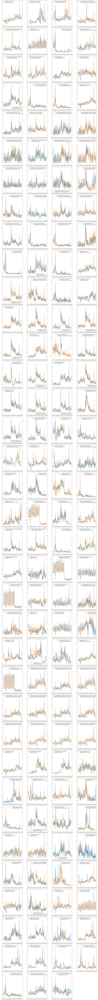

In [84]:
# visualized result by set rank = 1
plt.figure(figsize = (20,200))
i  = 1
for food_A in result_df_rank.index:
    plt.subplot(36,4,i)
    food_B = result_df_rank.loc[food_A]['food_B']
    df_viz = df_normalized[[food_A,food_B]]
    sns.lineplot(data = df_viz)
    i += 1
plt.tight_layout()

In [85]:
b = b.reset_index(drop = True)

In [86]:
b

,MSE_AB,food_A,food_B
0,0.266227,#CENCARU (KG) (9007),MABONG (KG) (8647)
1,0.364116,#SOTONG PUTIH (KG) (9067),IKAN TERUBOK - PCSS(8346)
2,0.741276,#UDANG SEDERHANA (KG)(9085),PATIN HITAM (KG) (9055)
3,0.102914,333 GOLD LONG FISH CAKE 200G/PACK,333 GOLD SMALL WHITE FISH BALL 135G/PACK
4,0.102914,333 GOLD SMALL WHITE FISH BALL 135G/PACK,333 GOLD LONG FISH CAKE 200G/PACK
...,...,...,...
139,1.123230,UG STEAMBOAT BALLS ASSORTED KG,KAMI SLICED ABALONE
140,1.141910,UG YONG TOFU ASSORTED PCS,UG STEAMBOAT BALLS ASSORTED KG
141,0.156154,US SCALLOP MEAT(20/30) 200G,BOILED HOTATE SCALLOP 300GM
142,0.404925,WHOLE SHELL MUSSEL 400GM (9439),MUSHROOM SMALL FRIED FISHBALL 160G/PKT


In [87]:
result = b.merge(result_df,how = 'inner',on = ['food_A','food_B'])

In [88]:
result = result.set_index('food_A')

In [89]:
result

,MSE_AB,food_B,beta,rank
food_A,,,,
#CENCARU (KG) (9007),0.266227,MABONG (KG) (8647),0.866147,1.0
#SOTONG PUTIH (KG) (9067),0.364116,IKAN TERUBOK - PCSS(8346),0.816931,1.0
333 GOLD LONG FISH CAKE 200G/PACK,0.102914,333 GOLD SMALL WHITE FISH BALL 135G/PACK,0.948257,1.0
333 GOLD SMALL WHITE FISH BALL 135G/PACK,0.102914,333 GOLD LONG FISH CAKE 200G/PACK,0.948257,1.0
BAWAL EMAS PCS (8148),0.170950,FRZ SEA CUCUMBER 500G,0.914050,1.0
...,...,...,...,...
UG STEAMBOAT BALLS ASSORTED KG,1.123230,KAMI SLICED ABALONE,0.435265,1.0
UG YONG TOFU ASSORTED PCS,1.141910,UG STEAMBOAT BALLS ASSORTED KG,0.425873,1.0
US SCALLOP MEAT(20/30) 200G,0.156154,BOILED HOTATE SCALLOP 300GM,0.921489,1.0


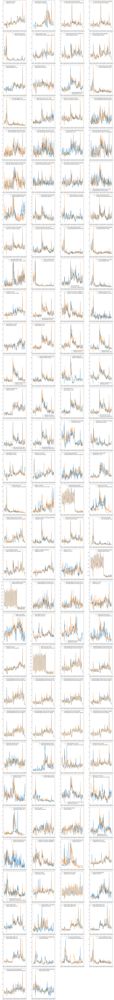

In [90]:
plt.figure(figsize = (20,200))
i  = 1
for food_A in result.index:
    plt.subplot(36,4,i)
    food_B = result.loc[food_A]['food_B']
    df_viz = df_normalized[[food_A,food_B]]
    sns.lineplot(data = df_viz)
    i += 1
plt.tight_layout()